<a href="https://colab.research.google.com/github/esma-nur/Anomaly-Detection-Anomalib-Library/blob/main/fastflow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [52]:
import os


In [53]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [54]:
DATA_DIR = '/content/drive/MyDrive/mvtec-wood'

In [55]:
!pip install anomalib==0.3.6

In [56]:
!pip install kornia==0.6.9

In [57]:
import numpy as np
import matplotlib.pyplot as plt
import os, pprint, yaml, warnings, math, glob, cv2, random, logging

def warn(*args, **kwargs):
    pass
warnings.warn = warn
warnings.filterwarnings('ignore')
logger = logging.getLogger("anomalib")

import anomalib


In [58]:
print(anomalib.__version__)

0.3.6


In [59]:
from pytorch_lightning import Trainer, seed_everything

In [60]:
import anomalib
from pytorch_lightning import Trainer, seed_everything
from anomalib.models import get_model
from anomalib.data import get_datamodule
from anomalib.utils.loggers import configure_logger, get_experiment_logger
from anomalib.utils.callbacks import LoadModelCallback, get_callbacks
from anomalib.config import get_configurable_parameters

In [61]:
import torch
print(torch.__version__)
print(torch.version.cuda)
print(torch.backends.cudnn.version())
print(torch.cuda.is_available())
print(torch.cuda.device_count())

print(torch.cuda.device(0))


1.11.0+cu102
10.2
7605
False
0


Model Config Path

Currently, there are 10 anomaly detection models available in anomalib library. Namely,

Patchcore
Padim
DFKDE
DFM
CFlow
Ganomaly
STFPM
FastFlow
DREAM
Reverse Distillation

In [62]:
CONFIG_PATHS = '/usr/local/lib/python3.10/dist-packages/anomalib/models'
MODEL_CONFIG_PAIRS = {
    'patchcore': f'{CONFIG_PATHS}/patchcore/config.yaml',
    'padim':     f'{CONFIG_PATHS}/padim/config.yaml',
    'cflow':     f'{CONFIG_PATHS}/cflow/config.yaml',
    'dfkde':     f'{CONFIG_PATHS}/dfkde/config.yaml',
    'dfm':       f'{CONFIG_PATHS}/dfm/config.yaml',
    'ganomaly':  f'{CONFIG_PATHS}/ganomaly/config.yaml',
    'stfpm':     f'{CONFIG_PATHS}/stfpm/config.yaml',
    'fastflow':  f'{CONFIG_PATHS}/fastflow/config.yaml',
    'draem':     f'{CONFIG_PATHS}/draem/config.yaml',
    'reverse_distillation': f'{CONFIG_PATHS}/reverse_distillation/config.yaml',
}

In [63]:
MODEL = 'fastflow'
print(open(os.path.join(MODEL_CONFIG_PAIRS[MODEL]), 'r').read())

dataset:
  name: mvtec #options: [mvtec, btech, folder]
  format: mvtec
  path: ./datasets/MVTec
  task: segmentation
  category: bottle
  image_size: 256 # options: [256, 256, 448, 384] - for each supported backbone
  train_batch_size: 32
  test_batch_size: 32
  num_workers: 8
  transform_config:
    train: null
    val: null
  create_validation_set: false
  tiling:
    apply: false
    tile_size: null
    stride: null
    remove_border_count: 0
    use_random_tiling: False
    random_tile_count: 16

model:
  name: fastflow
  backbone: resnet18 # options: [resnet18, wide_resnet50_2, cait_m48_448, deit_base_distilled_patch16_384]
  pre_trained: true
  flow_steps: 8 # options: [8, 8, 20, 20] - for each supported backbone
  hidden_ratio: 1.0 # options: [1.0, 1.0, 0.16, 0.16] - for each supported backbone
  conv3x3_only: True # options: [True, False, False, False] - for each supported backbone
  lr: 0.001
  weight_decay: 0.00001
  early_stopping:
    patience: 3
    metric: pixel_AUROC
  

In [64]:
DATA_DIR = '/usr/local/lib/python3.10/dist-packages/anomalib/'


In [65]:
new_update = {
    "path": '/content/drive/MyDrive/mv-tec-wood',
    'category': 'wood',
    'image_size': 256,
    'train_batch_size':48,
    'seed': 101
}

In [66]:
# update yaml key's value
def update_yaml(old_yaml, new_yaml, new_update):
    # load yaml
    with open(old_yaml) as f:
        old = yaml.safe_load(f)
        max_epoches=10

    temp = []
    def set_state(old, key, value):
        if isinstance(old, dict):
            for k, v in old.items():
                if k == 'project':
                    temp.append(k)
                if k == key:
                    if temp and k == 'path':
                        # right now, we don't wanna change `project.path`
                        continue
                    old[k] = value
                elif isinstance(v, dict):
                    set_state(v, key, value)

    # iterate over the new update key-value pari
    for key, value in new_update.items():
        set_state(old, key, value)


    # save the updated / modified yaml file
    with open(new_yaml, 'w') as f:
        yaml.safe_dump(old, f, default_flow_style=False)


In [67]:
# let's set a new path location of new config file
new_yaml_path = CONFIG_PATHS + '/' + list(MODEL_CONFIG_PAIRS.keys())[0] + '_new.yaml'

# run the update yaml method to update desired key's values
update_yaml(MODEL_CONFIG_PAIRS[MODEL], new_yaml_path, new_update)

In [68]:
with open(new_yaml_path) as f:
    updated_config = yaml.safe_load(f)
pprint.pprint(updated_config) # check if it's updated

{'dataset': {'category': 'wood',
             'create_validation_set': False,
             'format': 'mvtec',
             'image_size': 256,
             'name': 'mvtec',
             'num_workers': 8,
             'path': '/content/drive/MyDrive/mv-tec-wood',
             'task': 'segmentation',
             'test_batch_size': 32,
             'tiling': {'apply': False,
                        'random_tile_count': 16,
                        'remove_border_count': 0,
                        'stride': None,
                        'tile_size': None,
                        'use_random_tiling': False},
             'train_batch_size': 48,
             'transform_config': {'train': None, 'val': None}},
 'logging': {'log_graph': False, 'logger': []},
 'metrics': {'image': ['F1Score', 'AUROC'],
             'pixel': ['F1Score', 'AUROC'],
             'threshold': {'adaptive': True,
                           'image_default': 0,
                           'pixel_default': 0}},
 'model': {'

In [69]:
if updated_config['project']['seed'] != 0:
    print(updated_config['project']['seed'])
    seed_everything(updated_config['project']['seed'])

INFO:pytorch_lightning.utilities.seed:Global seed set to 101


101


In [70]:
# It will return the configurable parameters in DictConfig object.
config = get_configurable_parameters(
    model_name=updated_config['model']['name'],
    config_path=new_yaml_path
)

In [71]:
# pass the config file to model, logger, callbacks and datamodule
model      = get_model(config)
experiment_logger = get_experiment_logger(config)
callbacks  = get_callbacks(config)
datamodule = get_datamodule(config)

In [72]:
# start training
trainer = Trainer(**config.trainer, logger=experiment_logger, callbacks=callbacks)
trainer.fit(model=model, datamodule=datamodule)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_test_batches=1.0)` was configured so 100% of the batches will be used..
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_predict_batches=1.0)` was configured so 100% of the batches will be used..
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(val_check_interval=1.0)` was configured so validation will run at the end of the training epoch.

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [103]:
# load best model from checkpoint before evaluating
load_model_callback = LoadModelCallback(
    weights_path=trainer.checkpoint_callback.best_model_path
)
trainer.callbacks.insert(0, load_model_callback)
trainer.test(model=model, datamodule=datamodule)

INFO:pytorch_lightning.utilities.rank_zero:The following callbacks returned in `LightningModule.configure_callbacks` will override existing callbacks passed to Trainer: EarlyStopping


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │     0.964035153388977     │
│       image_F1Score       │    0.9833333492279053     │
│        pixel_AUROC        │    0.9496247172355652     │
│       pixel_F1Score       │    0.5479522347450256     │
└───────────────────────────┴───────────────────────────┘

[{'pixel_F1Score': 0.5479522347450256,
  'pixel_AUROC': 0.9496247172355652,
  'image_F1Score': 0.9833333492279053,
  'image_AUROC': 0.964035153388977}]

In [89]:
RESULT_PATH = os.path.join(
    updated_config['project']['path'],
    updated_config['model']['name'],
    updated_config['dataset']['format'],
    updated_config['dataset']['category']
)
RESULT_PATH

'./results/fastflow/mvtec/wood'

In [90]:
# a simple function to visualize the model's prediction (anomaly heatmap)
def vis(paths, n_images, is_random=True, figsize=(16, 16)):
    for i in range(n_images):
        image_name = paths[i]
        if is_random: image_name = random.choice(paths)
        img = cv2.imread(image_name)[:,:,::-1]

        category_type = image_name.split('/')[-4:-3:][0]
        defected_type = image_name.split('/')[-2:-1:][0]

        plt.figure(figsize=figsize)
        plt.imshow(img)
        plt.title(
            f"Category : {category_type} and Defected Type : {defected_type}",
            fontdict={'fontsize': 20, 'fontweight': 'medium'}
        )
        plt.xticks([])
        plt.yticks([])
        plt.tight_layout()
    plt.show()

In [91]:
for content in os.listdir(RESULT_PATH):
    if content == 'images':
        full_path = glob.glob(os.path.join(RESULT_PATH, content, '**',  '*.png'), recursive=True)
        print('Total Image ', len(full_path))
        print(full_path[0].split('/'))
        print(full_path[0].split('/')[-2:-1:])
        print(full_path[0].split('/')[-4:-3:])

Total Image  81
['.', 'results', 'fastflow', 'mvtec', 'wood', 'images', 'pixel_ROC.png']
['images']
['mvtec']


In [92]:
import os
import glob

for content in os.listdir(RESULT_PATH):
    if content == 'images':
        full_path = glob.glob(os.path.join(RESULT_PATH, content, '**',  '*.png'), recursive=True)
        print('Total Image ', len(full_path))
        if full_path:  # Check if full_path is not empty
            print(full_path[0].split('/'))
            print(full_path[0].split('/')[-2:-1:])
            print(full_path[0].split('/')[-4:-3:])
        else:
            print("No PNG files found in the 'images' directory.")


Total Image  81
['.', 'results', 'fastflow', 'mvtec', 'wood', 'images', 'pixel_ROC.png']
['images']
['mvtec']


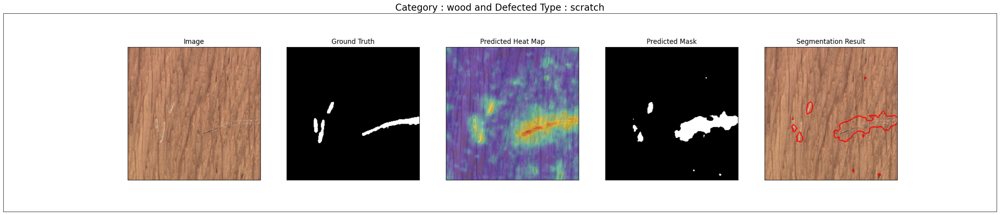

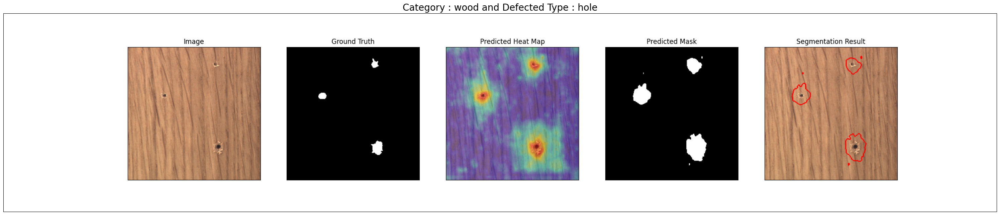

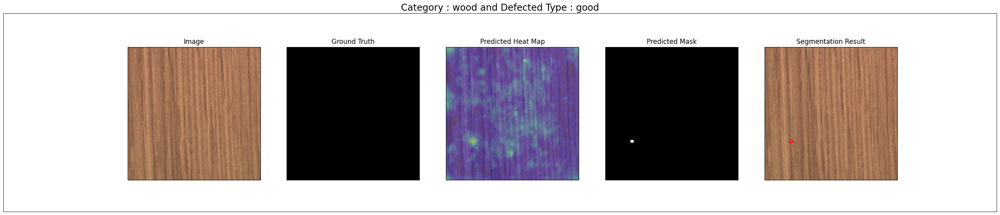

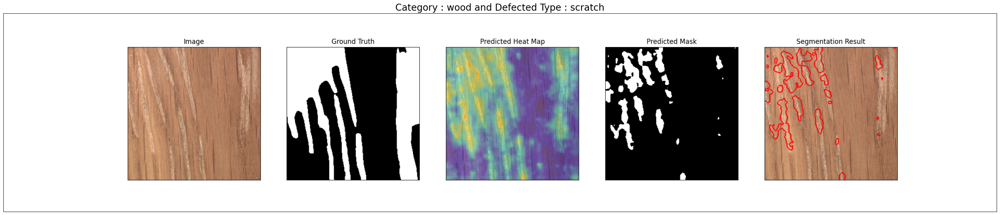

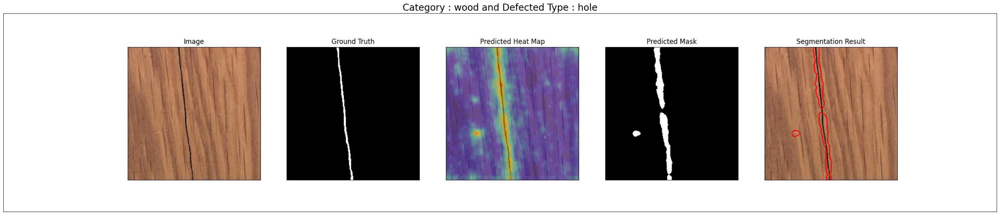

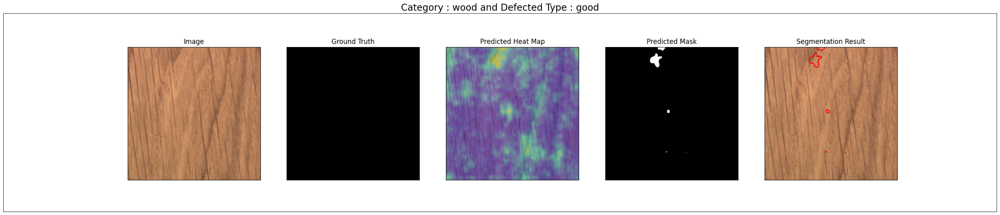

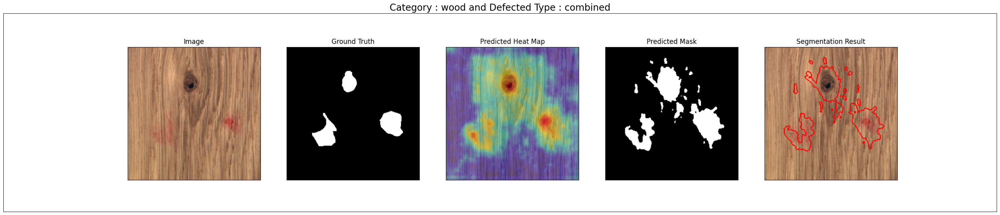

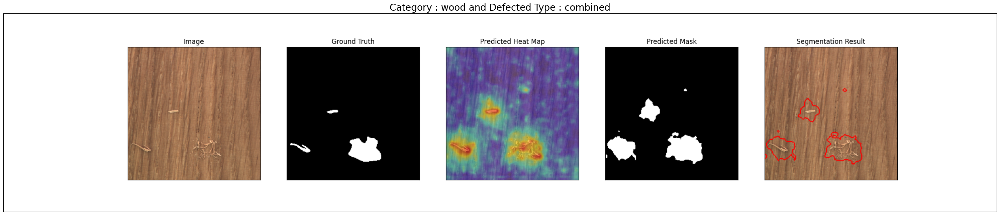

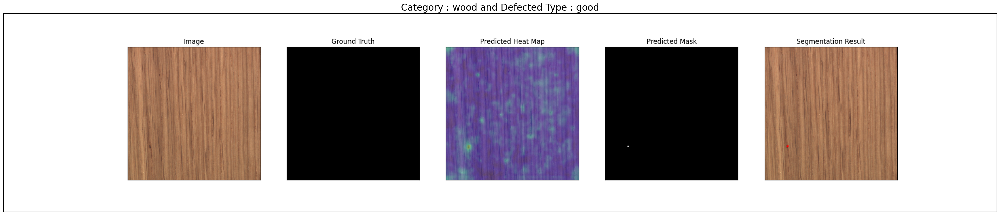

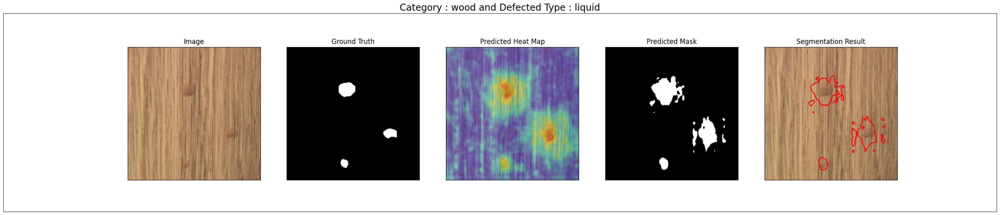

In [93]:
vis(full_path, 10, is_random=True, figsize=(30, 30))

**Inference**


In [94]:
from torchvision.datasets.folder import IMG_EXTENSIONS

img_paths = sorted(
        [
            os.path.join(dirpath,filename)
            for dirpath, _, filenames in os.walk(
                os.path.join(config.dataset.path, config.dataset.category, 'test')
            )
            for filename in filenames if filename.endswith(IMG_EXTENSIONS)
            and not filename.startswith(".")
        ],
    )

img_paths = [img_path for img_path in img_paths if not "good" in img_path]
img_paths = random.sample(img_paths, 2)
img_paths

['/content/drive/MyDrive/mv-tec-wood/wood/test/hole/008.png',
 '/content/drive/MyDrive/mv-tec-wood/wood/test/liquid/000.png']

In [96]:
infer_resutls = "results"
os.makedirs(infer_resutls, exist_ok=True)

In [132]:
infer_resutls = "/content/results/"
os.makedirs(infer_resutls, exist_ok=True)

In [112]:
with open('/usr/local/lib/python3.10/dist-packages/anomalib/deploy/inferencers/torch_inferencer.py', 'r') as file:
    content = file.read()
    print(content)


"""This module contains Torch inference implementations."""

# Copyright (C) 2022 Intel Corporation
# SPDX-License-Identifier: Apache-2.0

from pathlib import Path
from typing import Any, Dict, Optional, Union

import cv2
import numpy as np
import torch
from omegaconf import DictConfig, ListConfig
from torch import Tensor

from anomalib.config import get_configurable_parameters
from anomalib.deploy.optimize import get_model_metadata
from anomalib.models import get_model
from anomalib.models.components import AnomalyModule
from anomalib.pre_processing import PreProcessor

from anomalib.deploy.inferencers.base_inferencer import Inferencer


class TorchInferencer(Inferencer):
    """PyTorch implementation for the inference.

    Args:
        config (Union[str, Path, DictConfig, ListConfig]): Configurable parameters that are used
            during the training stage.
        model_source (Union[str, Path, AnomalyModule]): Path to the model ckpt file or the Anomaly model.
        meta_dat

In [111]:
file_path = "/usr/local/lib/python3.10/dist-packages/anomalib/deploy/inferencers/torch_inferencer.py"

# Dosyayı oku
with open(file_path, "r") as file:
    content = file.read()

# İçeriği değiştir
content = content.replace("from .base_inferencer", "from anomalib.deploy.inferencers.base_inferencer")

# Değiştirilmiş içeriği dosyaya yaz
with open(file_path, "w") as file:
    file.write(content)

print("Dosya başarıyla değiştirildi.")


Dosya başarıyla değiştirildi.


In [133]:
for infer_img_path in img_paths:
    !python /usr/local/lib/python3.10/dist-packages/anomalib/deploy/inferencers/torch_inferencer.py  \
        --config anomalib/models/{updated_config['model']['name']}/config.yaml \
        --weights {trainer.checkpoint_callback.best_model_path} \
        --input {infer_img_path} \
        --output ./infer_results \
        --task "segmentation" \
        --visualization_mode "full"

In [134]:
print(os.listdir(infer_resutls))

['fastflow', 'stfpm', 'dfkde']


In [136]:
for folder_category in os.listdir(infer_resutls):
    folder_category_path = os.path.join(infer_resutls, folder_category)
    print(folder_category_path)

    for image_file in os.listdir("/content/results/fastflow/"):
        read_img = cv2.imread(os.path.join(folder_category_path, image_file))
        plt.figure(figsize=(15, 15))
        plt.imshow(read_img[:,:,::-1])
        plt.title(str(folder_category))
        plt.show()

/content/results/fastflow


TypeError: 'NoneType' object is not subscriptable

<Figure size 1500x1500 with 0 Axes>

Klasör: /content/results/fastflow/mvtec/wood/images/liquid


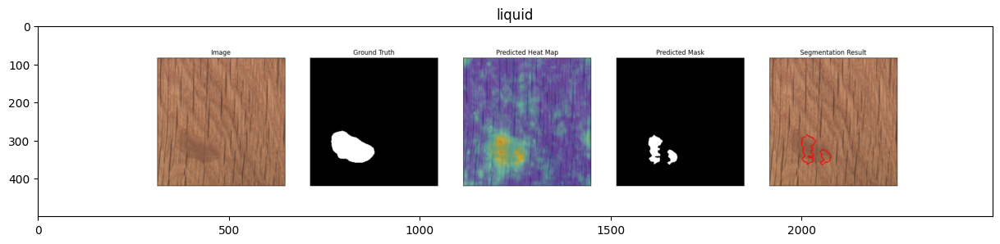

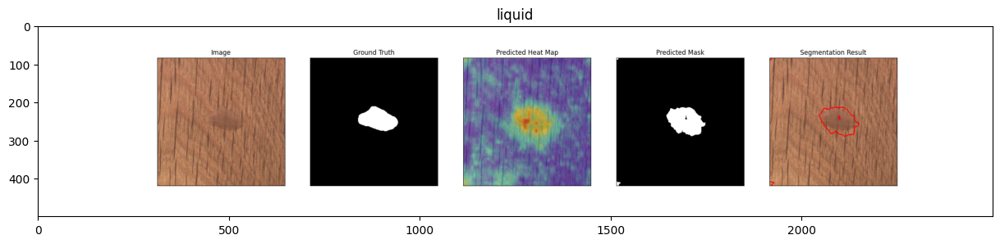

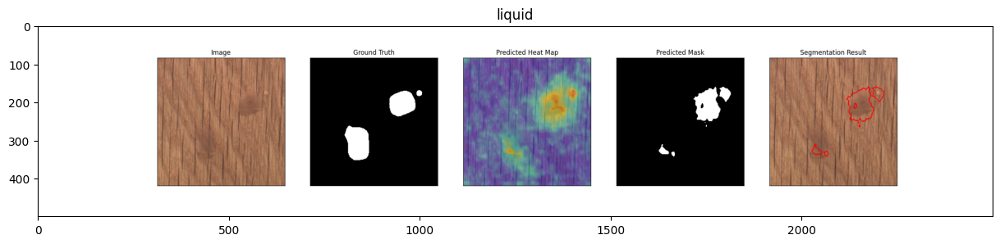

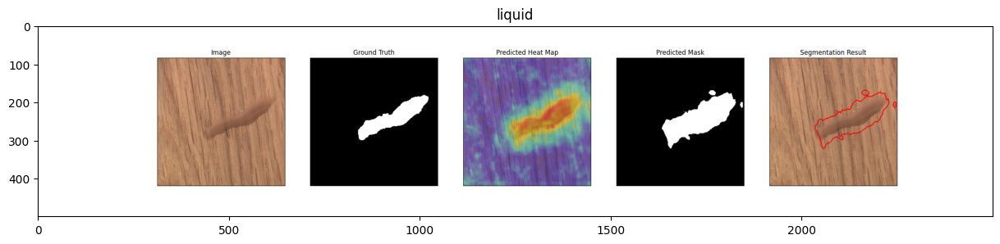

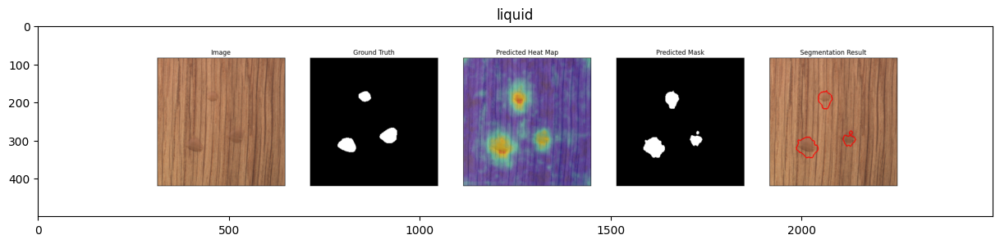

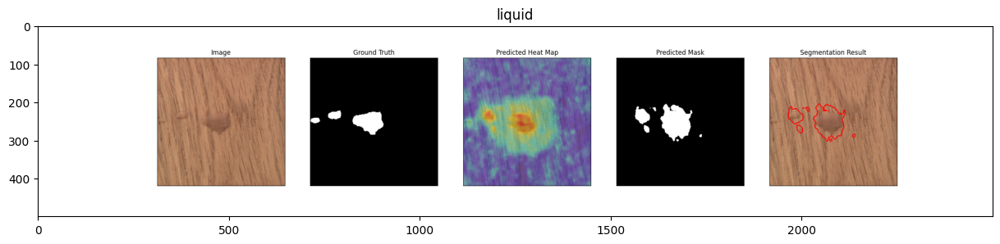

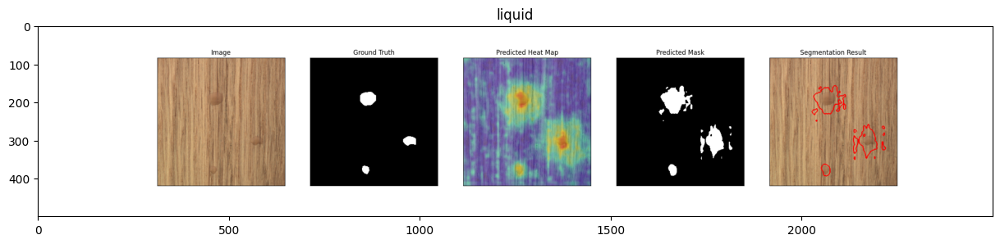

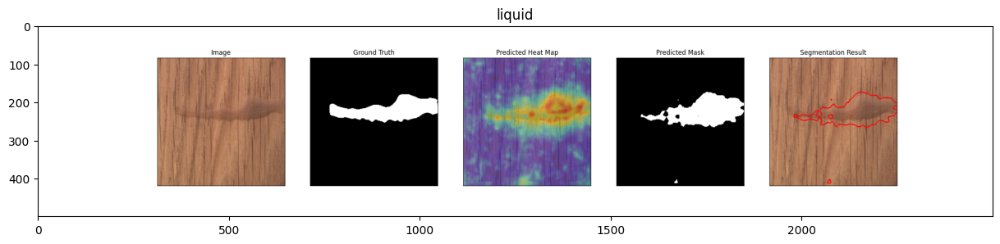

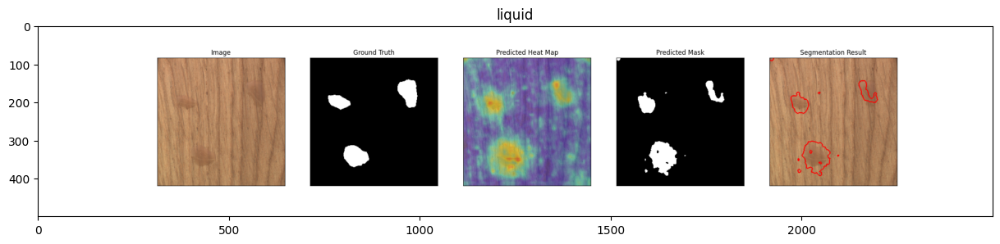

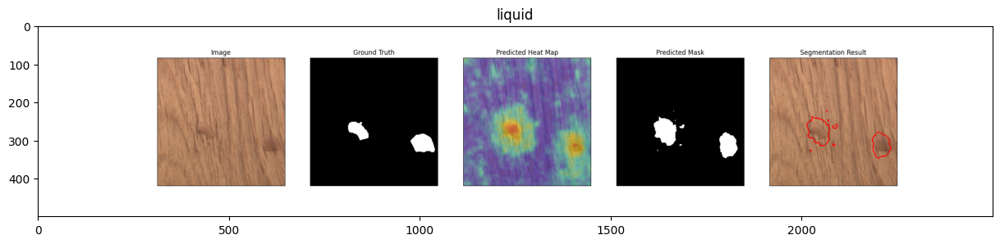

Klasör: /content/results/fastflow/mvtec/wood/images/color


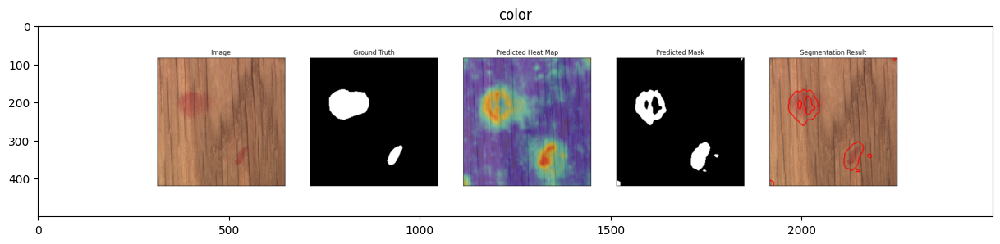

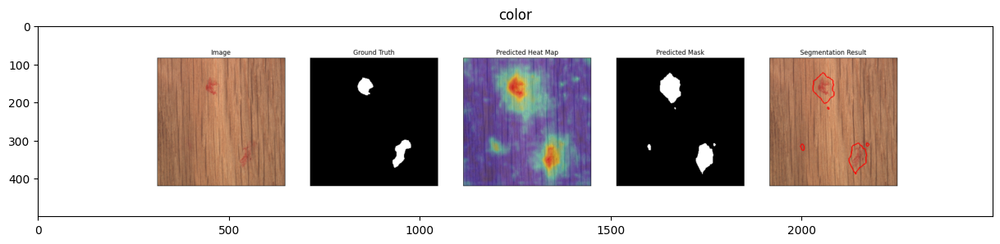

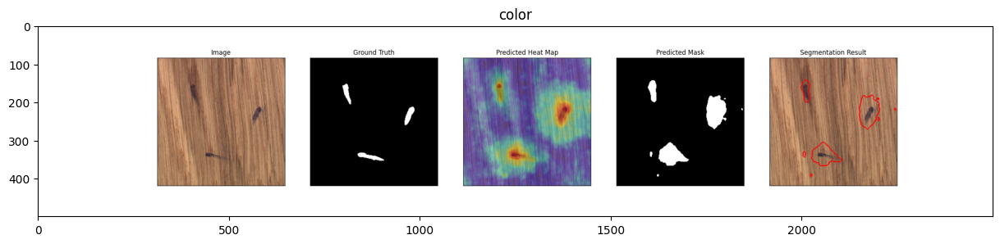

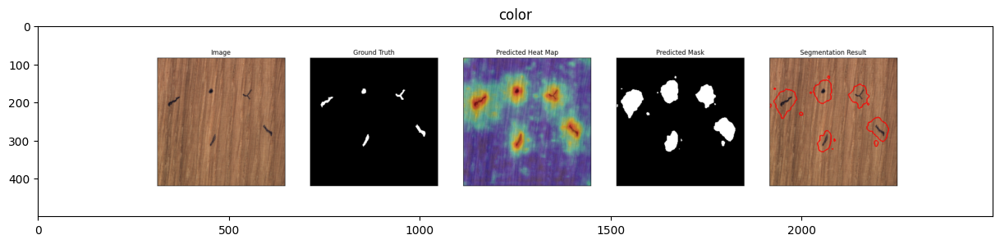

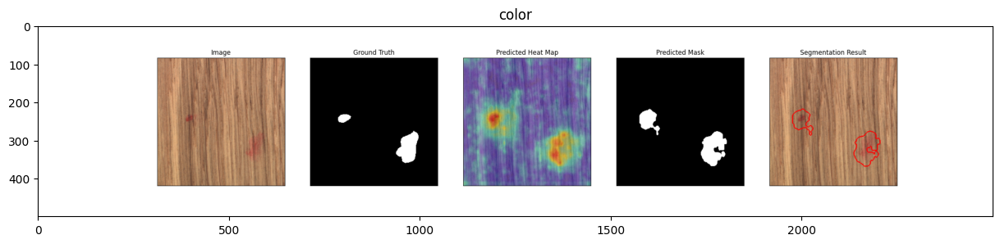

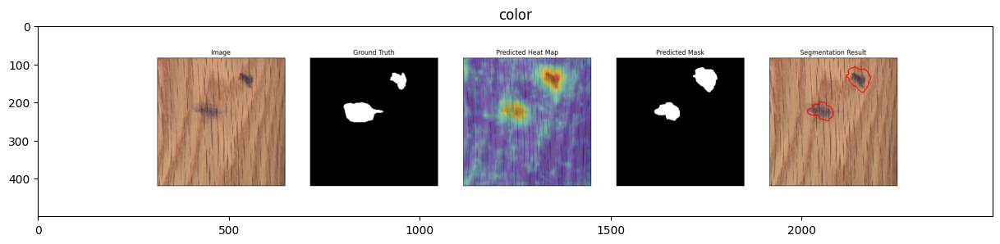

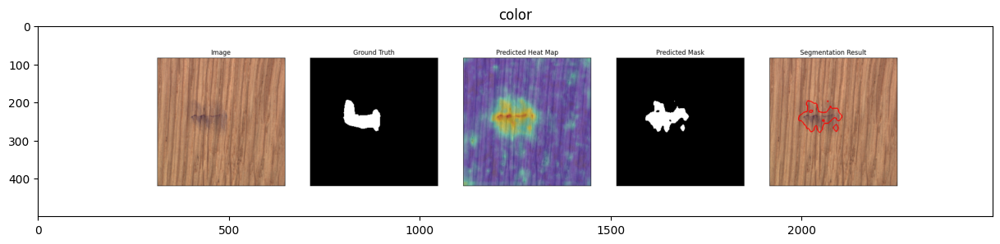

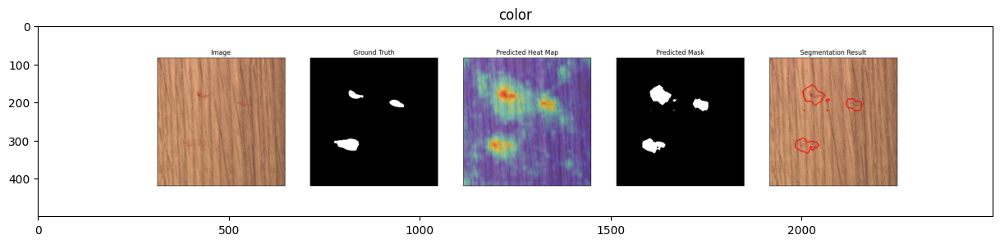

Klasör: /content/results/fastflow/mvtec/wood/images/good


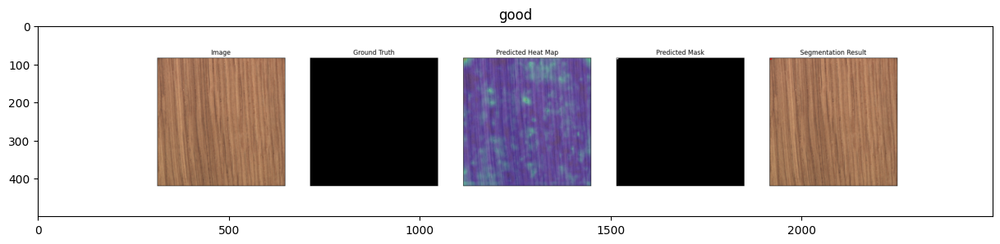

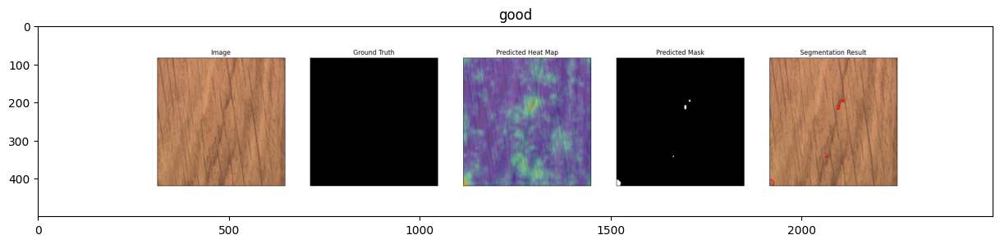

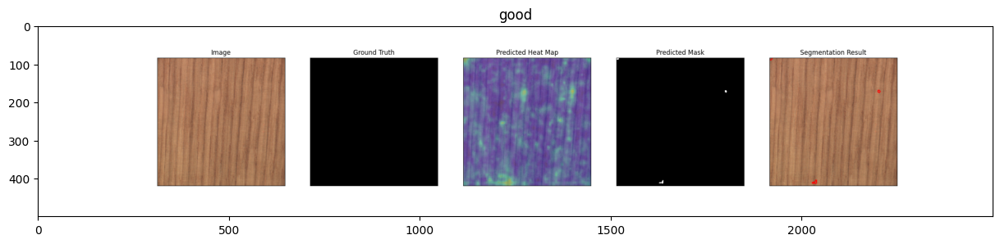

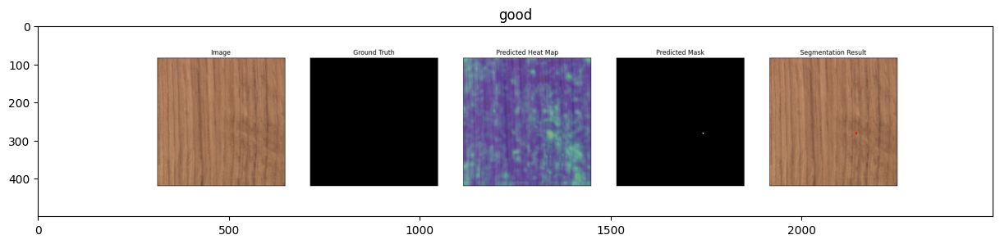

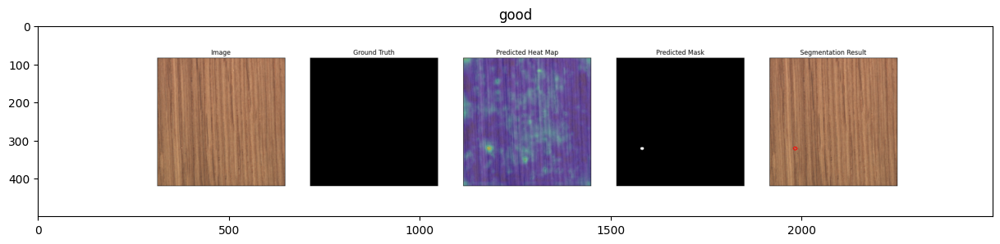

...

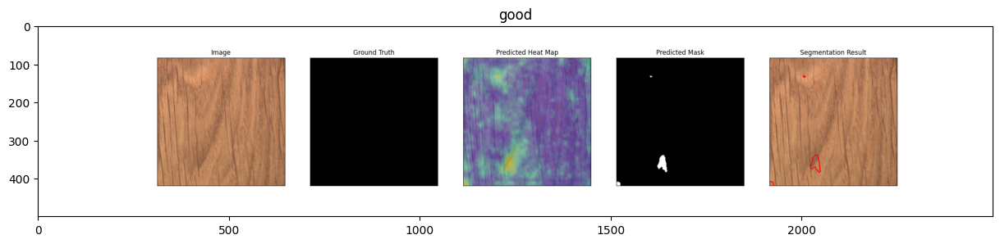

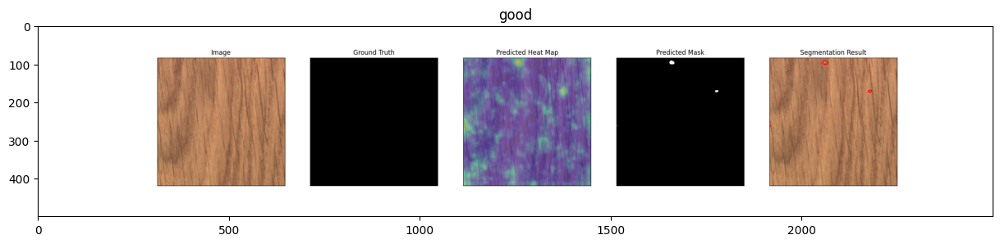

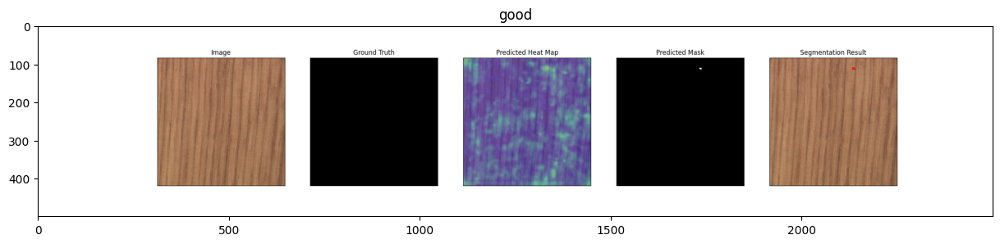

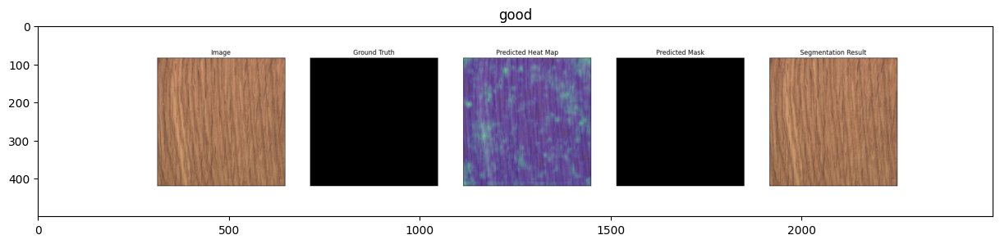

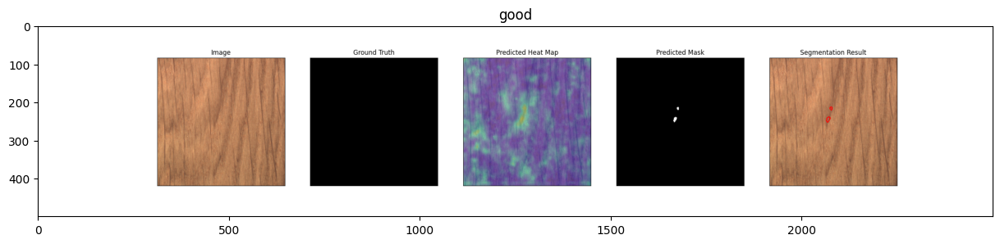

Klasör: /content/results/fastflow/mvtec/wood/images/hole


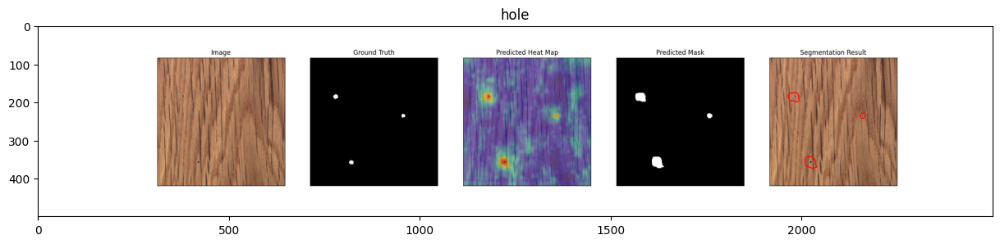

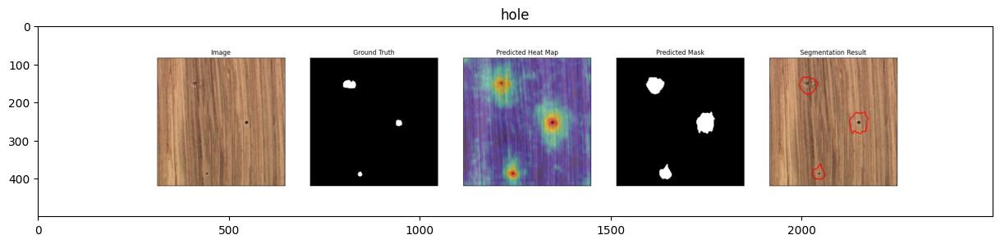

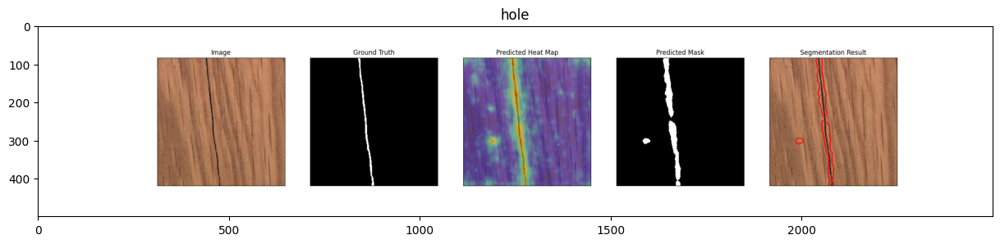

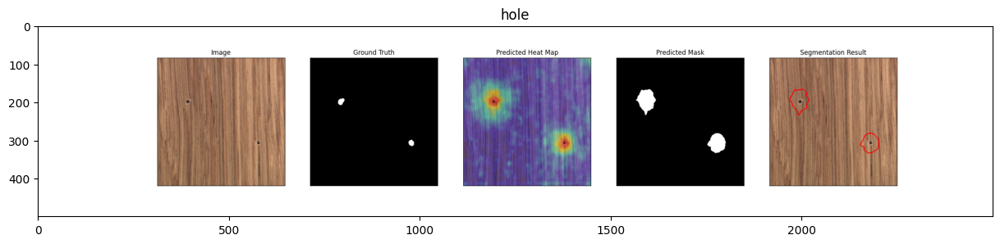

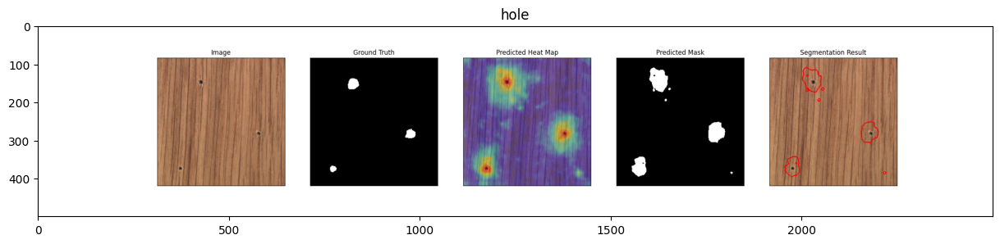

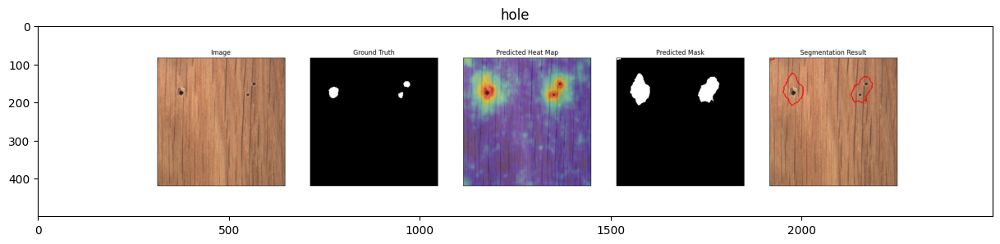

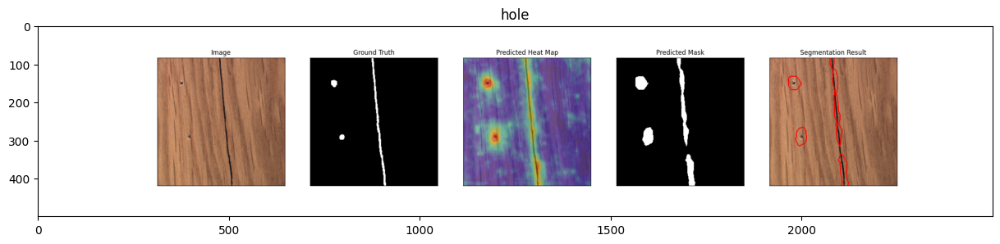

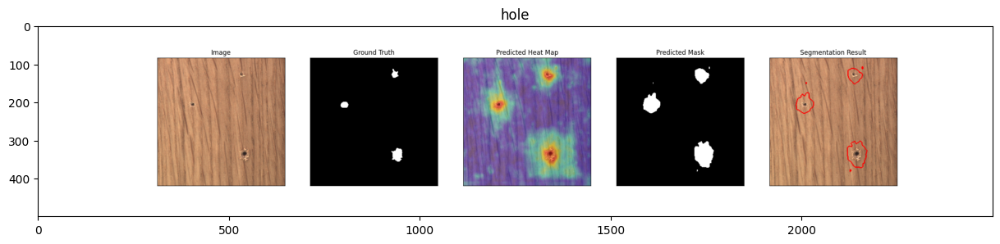

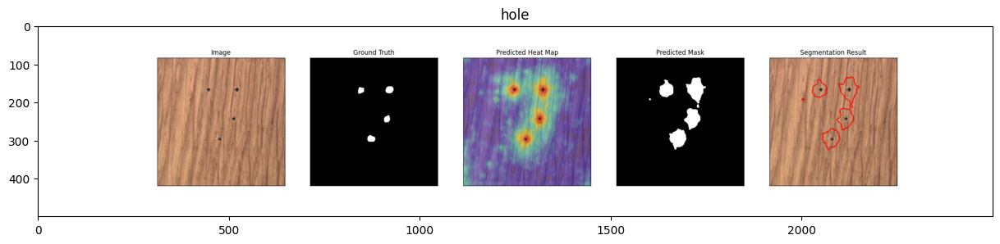

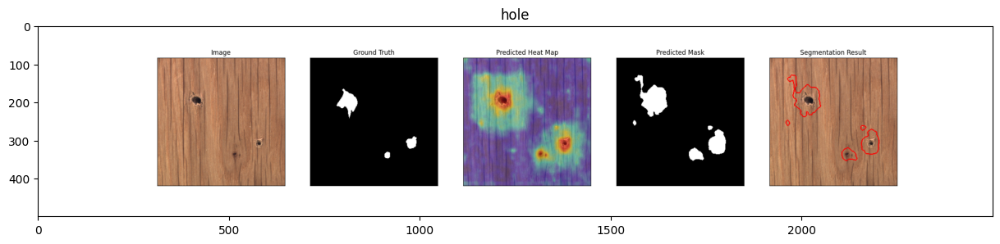

Klasör: /content/results/fastflow/mvtec/wood/images/pixel_ROC.png


NotADirectoryError: [Errno 20] Not a directory: '/content/results/fastflow/mvtec/wood/images/pixel_ROC.png'

In [139]:
import os
import cv2
import matplotlib.pyplot as plt

# Ana dizin
infer_results = "/content/results/fastflow/mvtec/wood/images/"

# Alt klasörleri dolaş
for folder_category in os.listdir(infer_results):
    folder_category_path = os.path.join(infer_results, folder_category)
    print("Klasör:", folder_category_path)

    # Her alt klasördeki görüntü dosyalarını işle
    for image_file in os.listdir(folder_category_path):
        image_path = os.path.join(folder_category_path, image_file)
        if os.path.isfile(image_path):  # Dosya kontrolü
            # Görüntüyü oku
            read_img = cv2.imread(image_path)
            if read_img is not None:  # Görüntü başarıyla okundu mu?
                plt.figure(figsize=(15, 15))
                plt.imshow(read_img[:,:,::-1])  # RGB formatına dönüştür
                plt.title(str(folder_category))
                plt.show()
            else:
                print(f"{image_path} okunamadı.")
        else:
            print(f"{image_path} bir dosya değil.")


In [85]:
def vis(paths, n_images, is_random=True, figsize=(16, 16)):
    for i in range(n_images):
        image_name = paths[i]
        if is_random: image_name = random.choice(paths)
        img = cv2.imread(image_name)[:,:,::-1]

        category_type = image_name.split('/')[-4:-3:][0]
        defected_type = image_name.split('/')[-2:-1:][0]

        plt.figure(figsize=figsize)
        plt.imshow(img)
        plt.title(
            f"Category : {category_type} and Defected Type : {defected_type}",
            fontdict={'fontsize': 20, 'fontweight': 'medium'}
        )
        plt.xticks([])
        plt.yticks([])
        plt.tight_layout()

In [86]:
for content in os.listdir(RESULT_PATH):
    if content == 'images':
        full_path = glob.glob(os.path.join(RESULT_PATH, content, '**',  '*.png'), recursive=True)
        print(len(full_path))
        print(full_path[0].split('/'))
        print(full_path[0].split('/')[-2:-1:])
        print(full_path[0].split('/')[-4:-3:])

81
['.', 'results', 'fastflow', 'mvtec', 'wood', 'images', 'pixel_ROC.png']
['images']
['mvtec']


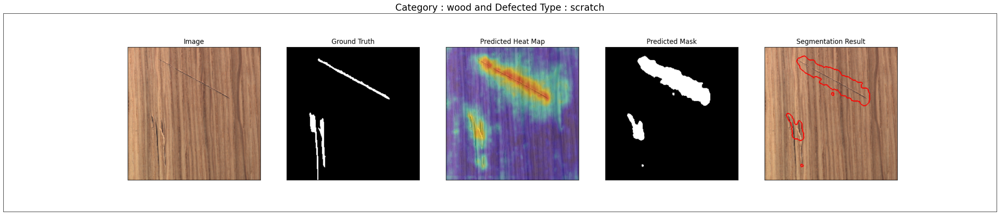

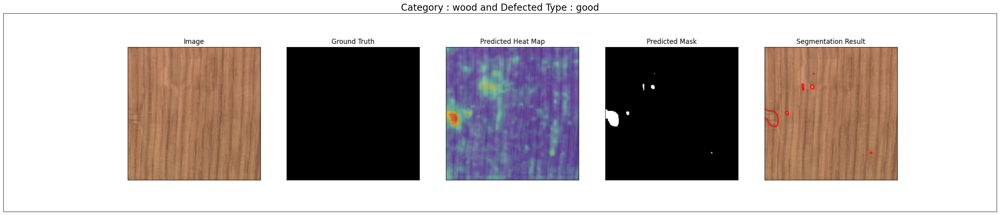

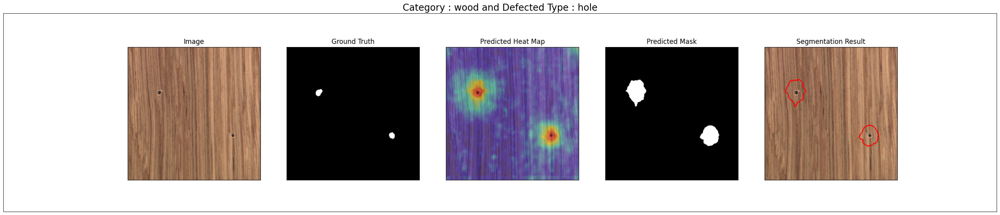

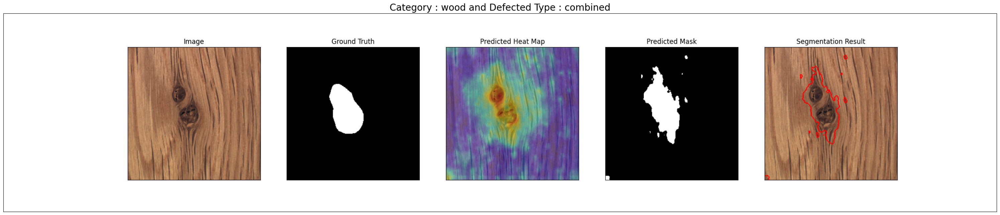

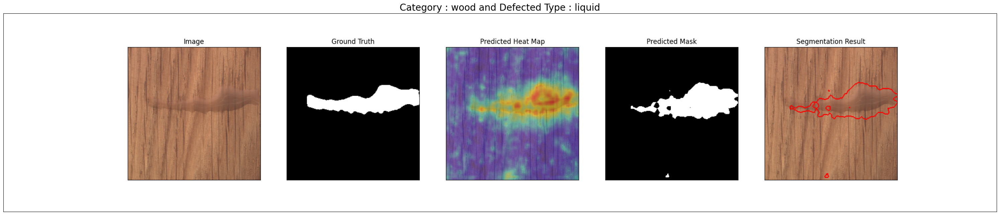

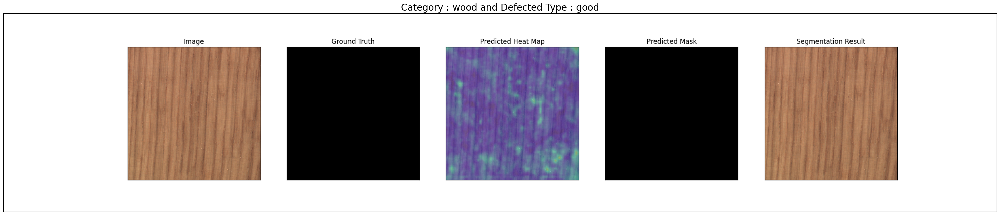

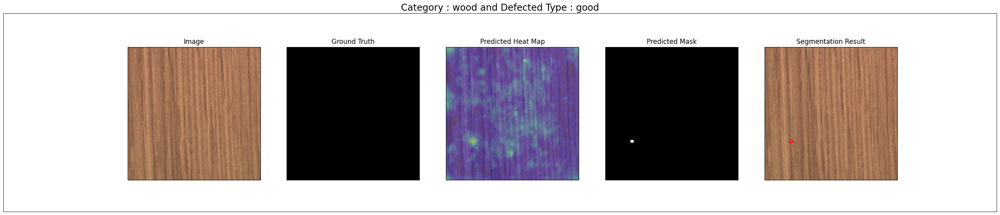

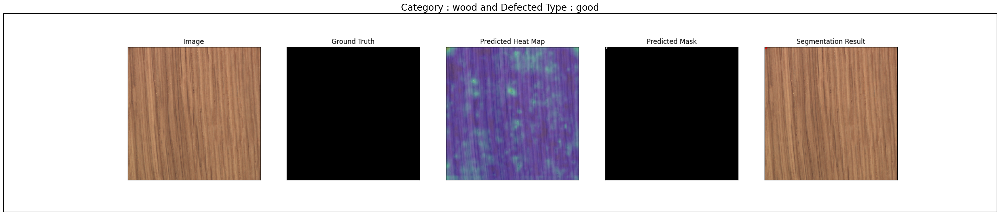

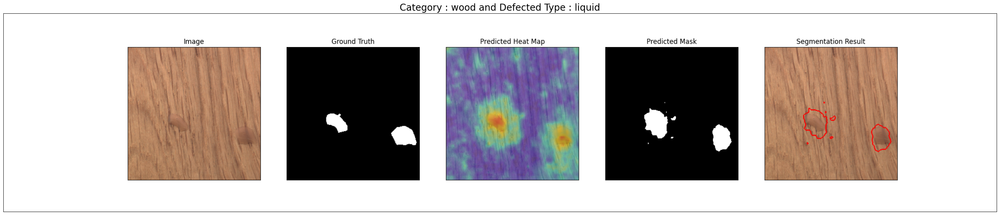

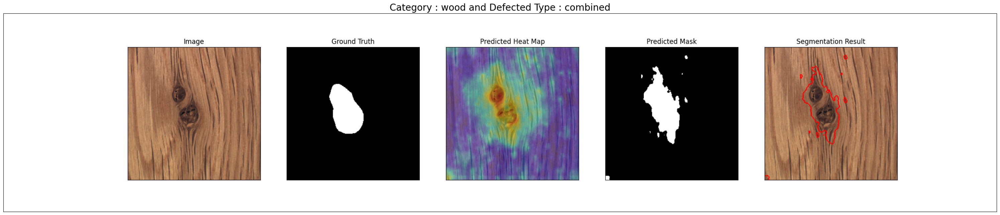

In [87]:
vis(full_path, 10, is_random=True, figsize=(30, 30))